# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

True

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [7]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [8]:
# n_epochs_kl_warmup = 600

# model_params = dict(
#     n_hidden=512,
#     n_layers=3, 
#     n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
#     gene_likelihood = "nb",
#     use_batch_norm = "none",
#     use_layer_norm = "both",
#     dropout_rate = 0.25,
#     deeply_inject_disentengled_latents = True,
#     include_auxillary_loss = True,
#     beta_kl_weight = 0.5,
#     encode_covariates = False,
# )

# train_params = dict(
#     max_epochs=600,
#     train_size=0.8,
#     batch_size=128,
#     check_val_every_n_epoch=10,
#     limit_train_batches=1.0, 
#     limit_val_batches=1.0,
#     learning_rate_monitor=True,
#     # early stopping:
#     early_stopping=False,
#     early_stopping_patience=150,
#     early_stopping_monitor="elbo_train",
#     plan_kwargs = dict(
#         n_epochs_kl_warmup=n_epochs_kl_warmup,
#         lr=1e-4,
#         weight_decay=1e-4,
#         optimizer="AdamW",
#         # lr-scheduler:
#         reduce_lr_on_plateau=True,
#         lr_patience=100,
#         lr_scheduler_metric="elbo_train",
#     )
# )

# dataset_params = dict(
#     layer=None, 
#     labels_key=None,
#     batch_key=None,
#     categorical_covariate_keys=None,
#     disentenglement_targets_configurations=disentenglement_targets_configurations,
#     model_level_metrics=model_level_metrics,
#     model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
# )

# tardis.MyModel.setup_anndata(adata, **dataset_params)
# dataset_params["adata_path"] = adata_file_path
# dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

# vae = tardis.MyModel(
#     adata,
#     **model_params
# )
# vae.train(**train_params)

# dir_path = os.path.join(
#     tardis.config.io_directories["models"],
#     "afriat_v2_4_encode"
# )

# vae.save(
#     dir_path,
#     overwrite=True,
# )

In [9]:
dir_path = os.path.join(
    tardis.config.io_directories["models"],
    "afriat_v2_4_encode"
)
vae = tardis.MyModel.load(dir_path=dir_path, adata=adata)

INFO     File /lustre/groups/ml01/workspace/kemal.inecik/tardis_data/models/afriat_v2_4_encode/model.pt already    
         downloaded                                                                                                


CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


In [24]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9996071286811009,
 ('train', 'total'): 0.999625388802435}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_831639/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_831639/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_831639/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_831639/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_831639/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


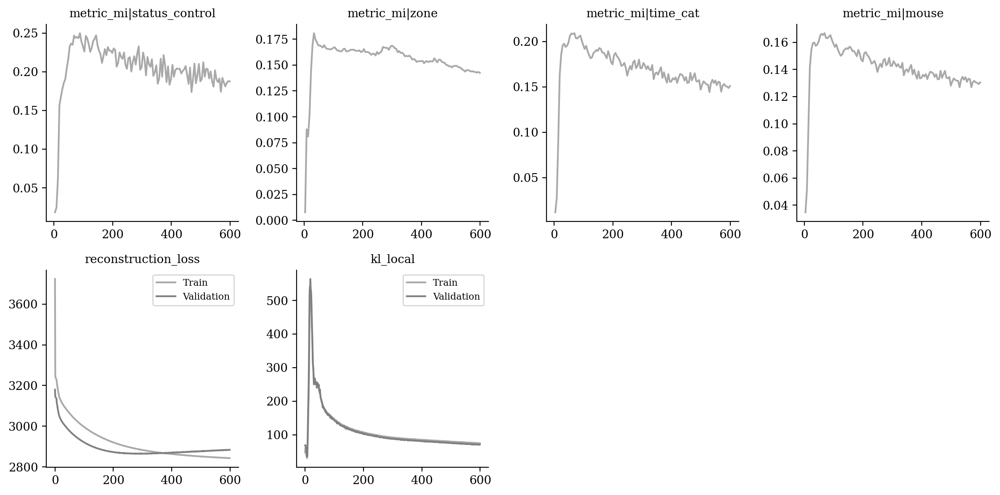

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

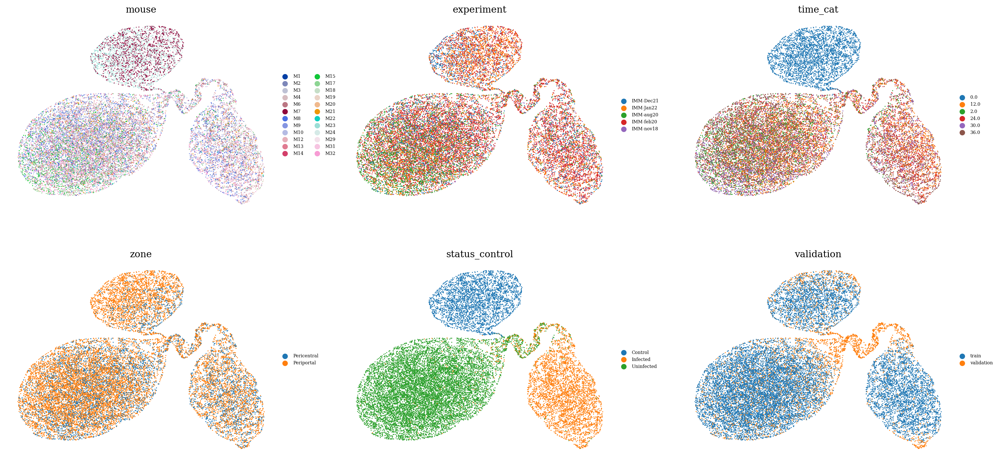

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

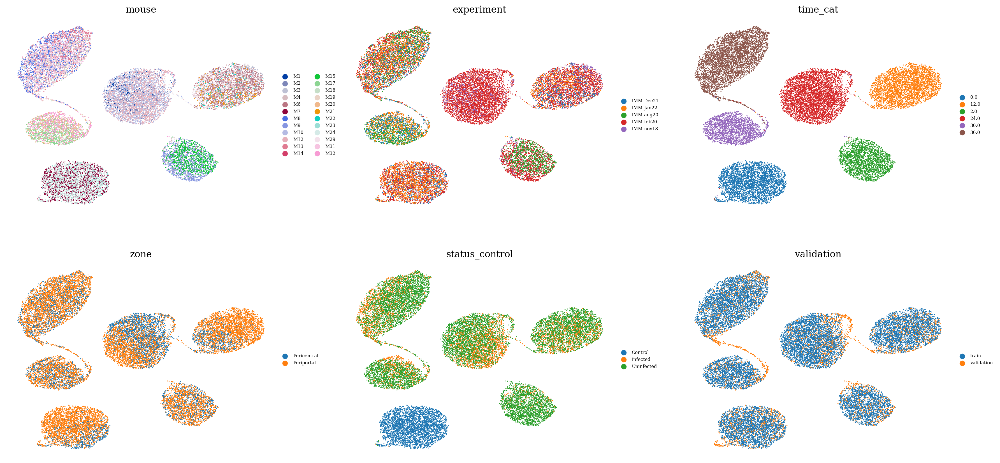

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

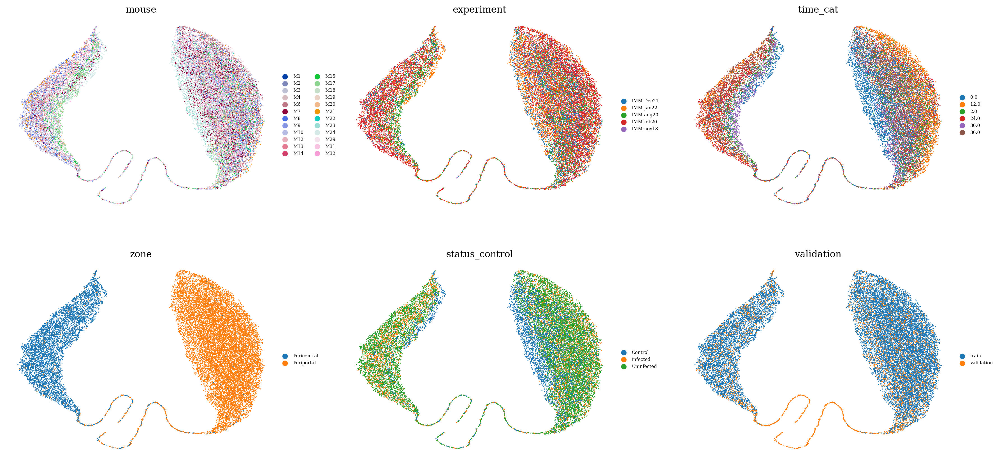

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

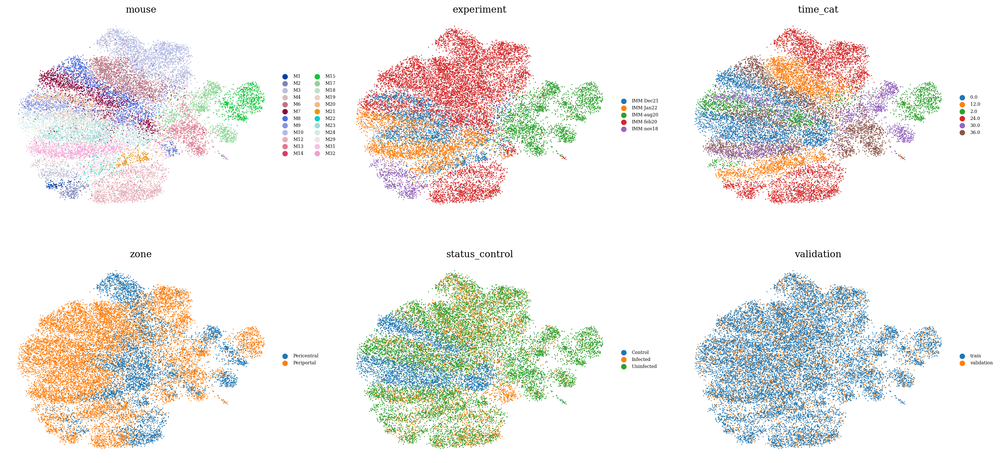

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

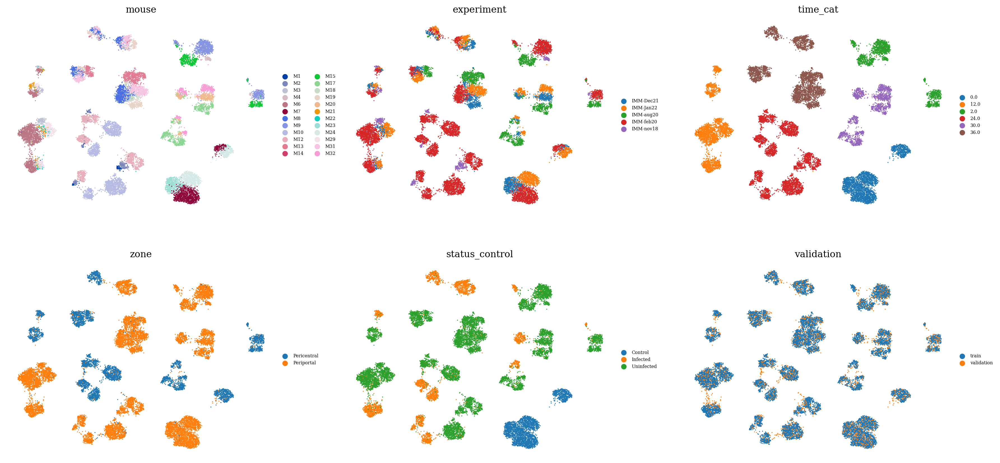

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

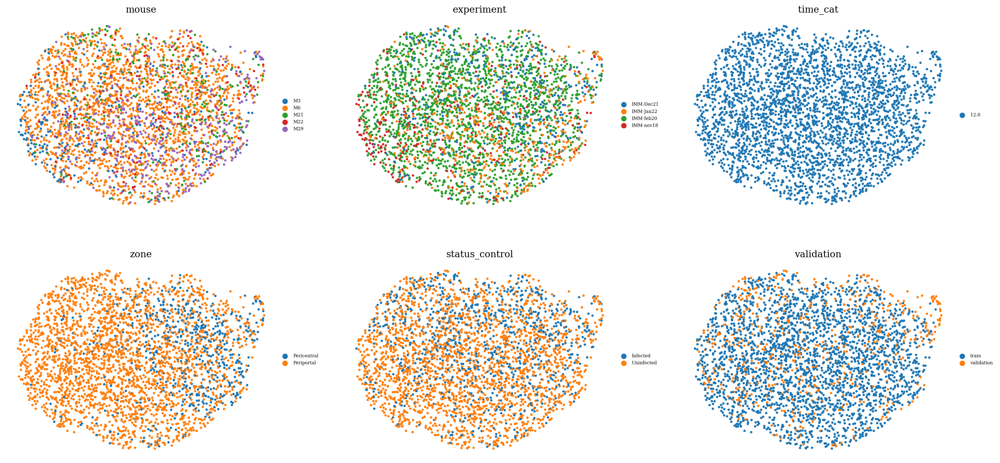

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [22]:
1

1

In [31]:
from tardis._utils.functions import label_transfer

In [32]:
k = "time_cat"
sublatent = DM.configurations.get_by_obs_key(k).reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

reference_embeddings = latent[vae.train_indices, :].copy()
query_embeddings = latent[vae.validation_indices, :].copy()

sc.pp.neighbors(reference_embeddings, n_neighbors=30)
label_transfer(reference_embeddings, query_embeddings, cluster_list=[k], neighbors_count=30)

predicted = query_embeddings.obs[f"transf_{k}"].astype(str).values
true = query_embeddings.obs[k].astype(str).values

import sklearn
metrics = {}
metrics['accuracy'] = sklearn.metrics.accuracy_score(true, predicted)
metrics['precision_macro'] = sklearn.metrics.precision_score(true, predicted, average='macro', zero_division=0)
metrics['recall_macro'] = sklearn.metrics.recall_score(true, predicted, average='macro', zero_division=0)
metrics['f1_score_macro'] = sklearn.metrics.f1_score(true, predicted, average='macro', zero_division=0)
metrics['precision_micro'] = sklearn.metrics.precision_score(true, predicted, average='micro', zero_division=0)
metrics['recall_micro'] = sklearn.metrics.recall_score(true, predicted, average='micro', zero_division=0)
metrics['f1_score_micro'] = sklearn.metrics.f1_score(true, predicted, average='micro', zero_division=0)
metrics['precision_weighted'] = sklearn.metrics.precision_score(true, predicted, average='weighted', zero_division=0)
metrics['recall_weighted'] = sklearn.metrics.recall_score(true, predicted, average='weighted', zero_division=0)
metrics['f1_score_weighted'] = sklearn.metrics.f1_score(true, predicted, average='weighted', zero_division=0)
metrics['confusion_matrix'] = sklearn.metrics.confusion_matrix(true, predicted)
metrics

{'accuracy': 0.9755905511811024,
 'precision_macro': 0.9697421256979318,
 'recall_macro': 0.9732267461167284,
 'f1_score_macro': 0.9710761270559213,
 'precision_micro': 0.9755905511811024,
 'recall_micro': 0.9755905511811024,
 'f1_score_micro': 0.9755905511811024,
 'precision_weighted': 0.97662309546241,
 'recall_weighted': 0.9755905511811024,
 'f1_score_weighted': 0.9758369601404374,
 'confusion_matrix': array([[660,   0,   0,   0,   6,   1],
        [  0, 611,   1,   6,   1,   0],
        [  0,   1, 412,   1,  22,   0],
        [  2,   1,   0, 858,   7,   5],
        [  0,   0,   5,   7, 374,   1],
        [  7,   2,   1,   2,  14, 802]])}

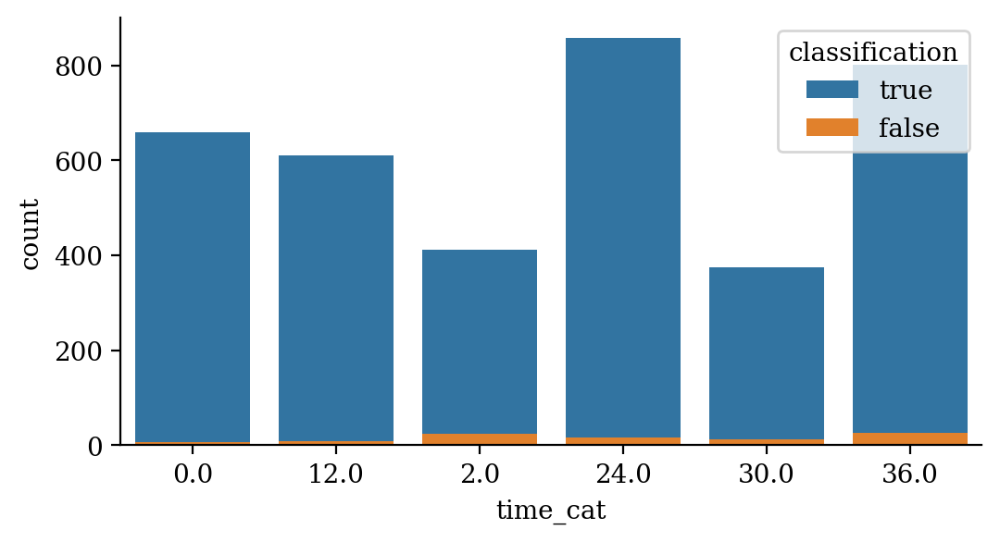

In [33]:
query_embeddings.obs["classification"] = 'false'
query_embeddings.obs.loc[query_embeddings.obs[k] == query_embeddings.obs[f"transf_{k}"], "classification"] = 'true'
grouped = query_embeddings.obs.groupby(k)['classification'].value_counts().rename('count').reset_index()

# Plotting the data
plt.figure(figsize=(6, 3))
# Create a barplot, which inherently supports stacking by using the 'hue' argument, and normalize the height by 'proportion'
sns.barplot(data=grouped, x=k, y='count', hue='classification', dodge=False)
sns.despine()
plt.show()

In [34]:
k = "zone"
sublatent = DM.configurations.get_by_obs_key(k).reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

reference_embeddings = latent[vae.train_indices, :].copy()
query_embeddings = latent[vae.validation_indices, :].copy()

sc.pp.neighbors(reference_embeddings, n_neighbors=30)
label_transfer(reference_embeddings, query_embeddings, cluster_list=[k], neighbors_count=30)

predicted = query_embeddings.obs[f"transf_{k}"].astype(str).values
true = query_embeddings.obs[k].astype(str).values

import sklearn
metrics = {}
metrics['accuracy'] = sklearn.metrics.accuracy_score(true, predicted)
metrics['precision_macro'] = sklearn.metrics.precision_score(true, predicted, average='macro', zero_division=0)
metrics['recall_macro'] = sklearn.metrics.recall_score(true, predicted, average='macro', zero_division=0)
metrics['f1_score_macro'] = sklearn.metrics.f1_score(true, predicted, average='macro', zero_division=0)
metrics['precision_micro'] = sklearn.metrics.precision_score(true, predicted, average='micro', zero_division=0)
metrics['recall_micro'] = sklearn.metrics.recall_score(true, predicted, average='micro', zero_division=0)
metrics['f1_score_micro'] = sklearn.metrics.f1_score(true, predicted, average='micro', zero_division=0)
metrics['precision_weighted'] = sklearn.metrics.precision_score(true, predicted, average='weighted', zero_division=0)
metrics['recall_weighted'] = sklearn.metrics.recall_score(true, predicted, average='weighted', zero_division=0)
metrics['f1_score_weighted'] = sklearn.metrics.f1_score(true, predicted, average='weighted', zero_division=0)
metrics['confusion_matrix'] = sklearn.metrics.confusion_matrix(true, predicted)
metrics

{'accuracy': 0.8813648293963254,
 'precision_macro': 0.856235632183908,
 'recall_macro': 0.8658246292342315,
 'f1_score_macro': 0.8607481363221181,
 'precision_micro': 0.8813648293963254,
 'recall_micro': 0.8813648293963254,
 'f1_score_micro': 0.8813648293963254,
 'precision_weighted': 0.8833609074727728,
 'recall_weighted': 0.8813648293963254,
 'f1_score_weighted': 0.8821523701958859,
 'confusion_matrix': array([[ 946,  198],
        [ 254, 2412]])}

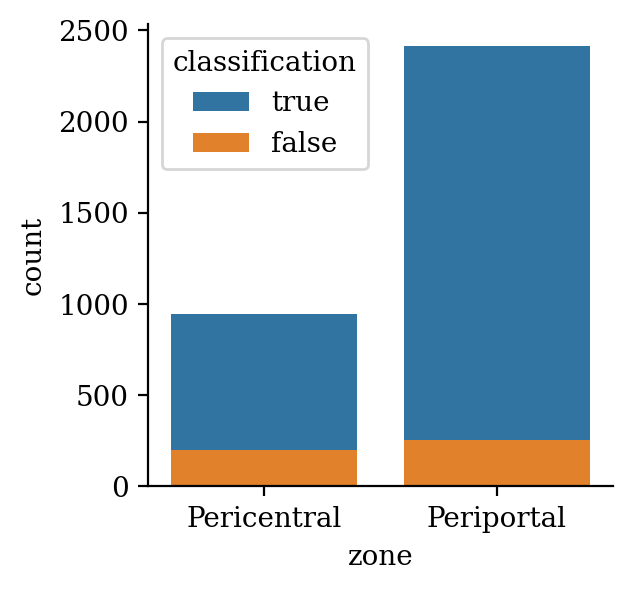

In [35]:
query_embeddings.obs["classification"] = 'false'
query_embeddings.obs.loc[query_embeddings.obs[k] == query_embeddings.obs[f"transf_{k}"], "classification"] = 'true'
grouped = query_embeddings.obs.groupby(k)['classification'].value_counts().rename('count').reset_index()

# Plotting the data
plt.figure(figsize=(3, 3))
# Create a barplot, which inherently supports stacking by using the 'hue' argument, and normalize the height by 'proportion'
sns.barplot(data=grouped, x=k, y='count', hue='classification', dodge=False)
sns.despine()
plt.show()

In [36]:
k = "status_control"
sublatent = DM.configurations.get_by_obs_key(k).reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

reference_embeddings = latent[vae.train_indices, :].copy()
query_embeddings = latent[vae.validation_indices, :].copy()

sc.pp.neighbors(reference_embeddings, n_neighbors=30)
label_transfer(reference_embeddings, query_embeddings, cluster_list=[k], neighbors_count=30)

predicted = query_embeddings.obs[f"transf_{k}"].astype(str).values
true = query_embeddings.obs[k].astype(str).values

import sklearn
metrics = {}
metrics['accuracy'] = sklearn.metrics.accuracy_score(true, predicted)
metrics['precision_macro'] = sklearn.metrics.precision_score(true, predicted, average='macro', zero_division=0)
metrics['recall_macro'] = sklearn.metrics.recall_score(true, predicted, average='macro', zero_division=0)
metrics['f1_score_macro'] = sklearn.metrics.f1_score(true, predicted, average='macro', zero_division=0)
metrics['precision_micro'] = sklearn.metrics.precision_score(true, predicted, average='micro', zero_division=0)
metrics['recall_micro'] = sklearn.metrics.recall_score(true, predicted, average='micro', zero_division=0)
metrics['f1_score_micro'] = sklearn.metrics.f1_score(true, predicted, average='micro', zero_division=0)
metrics['precision_weighted'] = sklearn.metrics.precision_score(true, predicted, average='weighted', zero_division=0)
metrics['recall_weighted'] = sklearn.metrics.recall_score(true, predicted, average='weighted', zero_division=0)
metrics['f1_score_weighted'] = sklearn.metrics.f1_score(true, predicted, average='weighted', zero_division=0)
metrics['confusion_matrix'] = sklearn.metrics.confusion_matrix(true, predicted)
metrics

{'accuracy': 0.8713910761154856,
 'precision_macro': 0.8728578203905778,
 'recall_macro': 0.8500494940489635,
 'f1_score_macro': 0.8594349567002905,
 'precision_micro': 0.8713910761154856,
 'recall_micro': 0.8713910761154856,
 'f1_score_micro': 0.8713910761154856,
 'precision_weighted': 0.8674156624577056,
 'recall_weighted': 0.8713910761154856,
 'f1_score_weighted': 0.8677811860844921,
 'confusion_matrix': array([[ 658,    1,    8],
        [   3,  543,  302],
        [   8,  168, 2119]])}

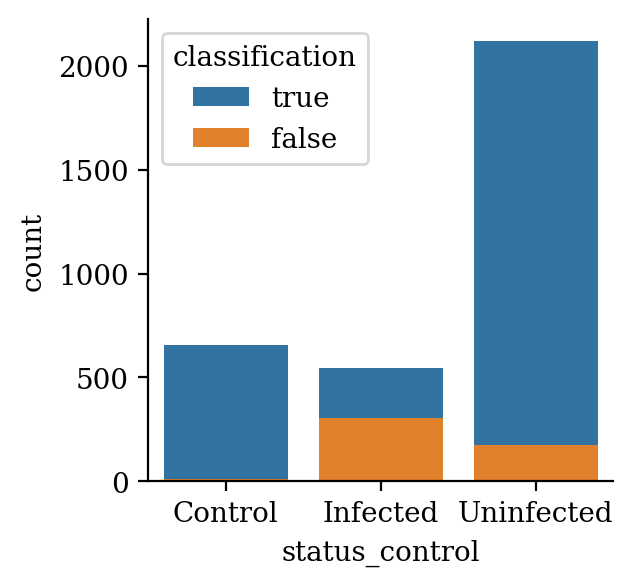

In [37]:
query_embeddings.obs["classification"] = 'false'
query_embeddings.obs.loc[query_embeddings.obs[k] == query_embeddings.obs[f"transf_{k}"], "classification"] = 'true'
grouped = query_embeddings.obs.groupby(k)['classification'].value_counts().rename('count').reset_index()

# Plotting the data
plt.figure(figsize=(3, 3))
# Create a barplot, which inherently supports stacking by using the 'hue' argument, and normalize the height by 'proportion'
sns.barplot(data=grouped, x=k, y='count', hue='classification', dodge=False)
sns.despine()
plt.show()